In [0]:
# !pip install fastai==0.7.0
# !pip install torch==0.4.1 torchvision==0.2.1
# !pip install imgaug

**After installing libraries kernel may be required to restart**

In [0]:
from fastai.conv_learner import *
from fastai.dataset import *
# from fastai import *
  
from pathlib import Path
from PIL import ImageDraw,ImageFont
from matplotlib import patches,patheffects

%matplotlib inline

In [0]:
import os

In [4]:
len(os.listdir('images'))

56791

In [0]:
path = Path('')
IMAGES = 'images'
df = pd.read_csv(path/'training.csv')

In [0]:
b_box = np.array(df.drop(columns='image_name')[['y1','x1','y2','x2']])
fnames = [path/IMAGES/i for i in df['image_name']]

!mkdir tmp

BB_CSV = path/'tmp/b_box_xf.csv'

bbs = [' '.join(str(p) for p in o) for o in b_box]
df2 = pd.DataFrame({'fn':df['image_name'],'bbox':bbs},columns=['fn','bbox'])
df2.to_csv(BB_CSV,index=False)

In [0]:
def bb_hw(b):
    return np.array([b[1],b[0],b[3]-b[1]+1,b[2]-b[0]+1])
  

  
def show_img(im , figsize=None,ax=None):
    if not ax: fig,ax=plt.subplots(figsize=figsize)
#     print(im.shape)
    ax.imshow(im)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    return ax
  

  
def draw_outline(o,lw):
    o.set_path_effects([patheffects.Stroke(linewidth=lw,foreground='black'),patheffects.Normal()])
    
    
    
def draw_rec(ax,b):
    patch = ax.add_patch(patches.Rectangle(b[:2],b[2],b[3],fill=False,edgecolor='red',lw=1))
    draw_outline(patch,4)

In [0]:
f_model = resnet34
sz = 480
bs = 32



In [0]:
tfm_y = TfmType.COORD
augs = [
        RandomFlip(tfm_y=tfm_y),
        RandomDihedral(tfm_y=tfm_y),
        RandomRotate(3, p=0.4, tfm_y=tfm_y),
        RandomLighting(0.1,0.1, tfm_y=tfm_y)]

tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, tfm_y=tfm_y, aug_tfms=augs)
md = ImageClassifierData.from_csv(path, IMAGES, BB_CSV, tfms=tfms, bs=bs, continuous=True)

In [0]:
# idx = 15
# fig ,axes = plt.subplots(3,3,figsize=(20,20))
# for i,ax in enumerate(axes.flat):
# #   x,y=next(iter(md.aug_dl))
#   x,y=next(iter(md.aug_dl))
#   ima = md.val_ds.denorm(to_np(x))[idx]
#   b = bb_hw(to_np(y[idx]))
#   print(b)
#   show_img(ima,ax=ax)
#   draw_rec(ax,b)

In [0]:
head_reg4 = nn.Sequential(Flatten(),
                          nn.Linear(115200,4)
                         )

learn = ConvLearner.pretrained(f_model,md,custom_head=head_reg4,pretrained=False)
learn.opt_fn = optim.Adam
learn.crit = nn.L1Loss()


In [0]:
# learn.model

In [0]:
# learn.summary()

In [0]:
learn.unfreeze()

 86%|████████▌ | 515/600 [20:57<03:20,  2.36s/it, loss=149]

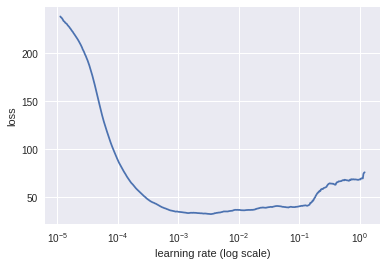

In [0]:
learn.lr_find(1e-5,10)
learn.sched.plot(5)

In [0]:
lr = 8e-5

In [0]:
learn.fit(lr,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      17.162588  14.946046 
    1      15.391503  14.190415 
    2      12.963924  11.616533 


[11.616533101399739]

In [0]:
learn.save("ures34_1")
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
tmp.h5
ures34_1.h5

sent 174,211,378 bytes  received 57 bytes  49,774,695.71 bytes/sec
total size is 3,505,155,027  speedup is 20.12


In [0]:
learn.load('ures34_1')
learn.unfreeze()

In [0]:
lr = 1e-4
lrs = np.array([lr/100,lr/10,lr])
lrss = np.array([6e-8,5e-7])

In [0]:
learn.fit(lr,3,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      11.865498  10.971784 
    1      13.175666  11.54094  
    2      11.199014  9.592642  
    3      12.999837  10.391731 
    4      11.474293  10.51921  
    5      10.4328    8.933146  
    6      9.478571   8.23319   


[8.233190046946207]

In [0]:
learn.save("ures34_2")
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_2.h5

sent 87,106,333 bytes  received 41 bytes  58,070,916.00 bytes/sec
total size is 3,592,238,809  speedup is 41.24


In [0]:
learn.load('ures34_2')
learn.unfreeze()
learn.precompute = False

In [0]:
learn.fit(lr/2,2,cycle_len=2,cycle_mult = 2)

epoch      trn_loss   val_loss   
    0      10.062613  8.57984   
    1      9.108232   7.964423  
    2      10.438918  8.899462  
    3      9.52946    8.583058  
    4      8.736976   7.592628  
    5      8.769053   7.401526  


[7.401526335080464]

In [0]:
learn.save('ures34_3')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
ures34_3.h5

sent 87,105,959 bytes  received 35 bytes  58,070,662.67 bytes/sec
total size is 4,212,998,814  speedup is 48.37


In [0]:
learn.load("ures34_3")
learn.unfreeze()
learn.precompute = False

In [0]:
learn.fit(lr/5,2,cycle_len=2,cycle_mult = 2)

epoch      trn_loss   val_loss   
    0      8.849249   7.840818  
    1      8.687957   7.34449   
    2      8.824846   7.633849  
    3      8.124394   7.428498  
    4      7.915697   7.19992   
    5      8.234      7.080134  


[7.080134121576945]

In [0]:
learn.save('ures34_4')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_4.h5

sent 87,106,009 bytes  received 38 bytes  174,212,094.00 bytes/sec
total size is 4,357,824,126  speedup is 50.03


In [0]:
learn.load("ures34_4")
learn.unfreeze()
learn.precompute = False

In [0]:
learn.fit(lr,3,cycle_len=1,cycle_mult = 2)

epoch      trn_loss   val_loss   
    0      8.992696   7.466356  
    1      9.689538   9.144485  
    2      8.417767   7.259411  
    3      10.136612  9.566449  
    4      9.568615   8.494674  
    5      8.624421   7.277906  
    6      7.544599   6.988081  


[6.988080584208171]

In [0]:
learn.save('ures34_5')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_5.h5

sent 87,106,053 bytes  received 41 bytes  58,070,729.33 bytes/sec
total size is 4,444,907,492  speedup is 51.03


In [0]:
learn.fit(lr/6,2,cycle_len=2,cycle_mult=2)

In [0]:
learn.save('upres34_6')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
upres34_6.h5

sent 87,106,059 bytes  received 35 bytes  58,070,729.33 bytes/sec
total size is 4,892,526,843  speedup is 56.17


In [0]:
learn.load('upres34_6')
learn.unfreeze()
learn.precompute = False

In [0]:
lr = 1e-4
lrs = np.array([lr/10,lr/6,lr])
lrss = np.array([6e-8,5e-7])

In [0]:
learn.fit(lr/6,3,cycle_len=2,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      7.540494   6.790512  
    1      6.894015   6.670021  
    2      7.807118   6.818449  
    3      7.489891   6.668419  
    4      6.956389   6.62673   
    5      7.210099   6.553376  
    6      7.590618   6.820534  
    7      7.617479   7.027171  
    8      7.488388   6.686779  
    9      7.36184    6.564763  
    10     7.429673   6.558402  
    11     6.732941   6.442864  
    12     6.903341   6.333093  
    13     7.077134   6.357389  


[6.357388647397359]

In [0]:
learn.save('ures34_7')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_7.h5

sent 87,106,097 bytes  received 38 bytes  58,070,756.67 bytes/sec
total size is 4,979,609,579  speedup is 57.17


In [0]:
learn.load('ures34_7')
learn.unfreeze()
learn.precompute = False

In [0]:
lr = 1e-4
lrs = np.array([lr/10,lr/6,lr])
lrss = np.array([6e-8,5e-7])

In [0]:
learn.fit(lr/100,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      6.755087   6.352278  
    1      6.577542   6.348273  
    2      6.807718   6.357051  



[6.357051383654277]

In [0]:
learn.save('ures34_8')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_8.h5

sent 87,106,314 bytes  received 39 bytes  58,070,902.00 bytes/sec
total size is 5,854,588,586  speedup is 67.21


In [0]:
learn.load('ures34_8')
learn.unfreeze()
learn.precompute = False

In [0]:
learn.fit(lr/10,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      5.730632   6.283157  
    1      5.795231   6.347876  
    2      6.098916   6.246857  



[6.246857350667318]

In [0]:
learn.save('ures34_9')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_9.h5

sent 87,107,218 bytes  received 42 bytes  58,071,506.67 bytes/sec
total size is 5,941,672,824  speedup is 68.21


In [0]:
learn.load('ures34_9')
learn.unfreeze()
learn.precompute = False

In [0]:
learn.models.ps = [.2,.3]

In [0]:
learn.fit(lr/10,1,cycle_len=3)

epoch      trn_loss   val_loss   
    0      6.06809    6.473654  
    1      5.428935   6.350152  
    2      5.443741   6.22887   



[6.228870323499044]

In [0]:
learn.save('ures34_10')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
ures34_10.h5

sent 87,106,411 bytes  received 39 bytes  58,070,966.67 bytes/sec
total size is 6,395,397,653  speedup is 73.42


In [0]:
learn.models.ps = 0

In [0]:
learn.load('ures34_10')
learn.unfreeze()
learn.precompute = False

In [0]:
lr = 1e-4
lrs = np.array([lr/100,lr/10,lr])
lrss = np.array([6e-8,5e-7])

In [0]:
learn.fit(lr,2,cycle_len=2,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      7.700226   7.126166  
    1      6.11596    6.2455    
    2      8.726758   8.238539  
    3      7.150249   6.966673  
    4      6.469797   6.238154  
 22%|██▎       | 135/600 [05:35<16:50,  2.17s/it, loss=6.18]

epoch      trn_loss   val_loss   
    0      7.700226   7.126166  
    1      6.11596    6.2455    
    2      8.726758   8.238539  
    3      7.150249   6.966673  
    4      6.469797   6.238154  
    5      6.277382   6.079798  

    5      6.277382   6.079798  



[6.079797981580098]

[6.079797981580098]

In [0]:
learn.save('ures34_11')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
ures34_11.h5

sent 87,107,170 bytes  received 36 bytes  58,071,470.67 bytes/sec
total size is 6,395,398,415  speedup is 73.42


In [0]:
learn.load('ures34_11')
learn.unfreeze()
learn.precompute = False

In [0]:
lr = 1e-4
lrs = np.array([lr/100,lr/10,lr])
lrss = np.array([6e-8,5e-7])

In [0]:
learn.fit(lr,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      6.443667   6.245387  
    1      7.017592   6.887512  
    2      5.78512    6.102842  



[6.102842173576355]

In [0]:
learn.save('ures34_12')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_12.h5

sent 87,107,226 bytes  received 42 bytes  58,071,512.00 bytes/sec
total size is 6,540,227,051  speedup is 75.08


In [0]:
learn.load('ures34_12')
learn.unfreeze()
learn.precompute = False

In [0]:
learn.models.ps = [0.0,0.0]

In [0]:
lr = 1e-4
lrs = np.array([lr/100,lr/10,lr])
lrss = np.array([6e-8,5e-7])

In [23]:
learn.fit(lr/10,1,cycle_len=3)

epoch      trn_loss   val_loss   
    0      6.163712   6.087235  
    1      5.937298   5.999056  
    2      5.683572   5.954493  


[5.954493149121602]

In [24]:
learn.save('ures34_13')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
ures34_13.h5

sent 87,106,541 bytes  received 36 bytes  34,842,630.80 bytes/sec
total size is 7,465,989,600  speedup is 85.71


In [0]:
learn.load('ures34_13')
learn.unfreeze()
learn.precompute = False

In [17]:
learn.fit(lr,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      6.549469   6.108812  
    1      6.08754    5.976341  


[5.976341236432393]

In [18]:
learn.save('ures34_14')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_14.h5

sent 87,106,641 bytes  received 39 bytes  34,842,672.00 bytes/sec
total size is 7,934,297,843  speedup is 91.09


In [0]:
learn.load('ures34_14')
learn.unfreeze()
learn.precompute = False

In [20]:
learn.fit(lrs/5,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      6.008621   5.997864  
    1      6.031211   5.901054  


[5.901053695678711]

In [21]:
learn.save('ures34_15')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_15.h5

sent 87,106,678 bytes  received 42 bytes  58,071,146.67 bytes/sec
total size is 8,021,381,209  speedup is 92.09


In [22]:
learn.fit(lrs/5,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      5.822868   5.919587  
    1      5.631929   5.887411  


[5.8874107344945275]

In [23]:
learn.save('ures34_16')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_16.h5

sent 87,106,713 bytes  received 45 bytes  58,071,172.00 bytes/sec
total size is 8,108,464,575  speedup is 93.09


In [28]:
learn.fit(lrs/10,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      5.708215   5.930444  
    1      5.614667   5.927736  


[5.927735996246338]

In [29]:
learn.save('ures34_17')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
ures34_17.h5

sent 87,106,746 bytes  received 48 bytes  58,071,196.00 bytes/sec
total size is 8,195,547,941  speedup is 94.09


In [30]:
learn.fit(lrs/5,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      5.748057   5.927757  
    1      5.549349   5.943623  


[5.94362272421519]

In [31]:
learn.save('weight')
# !rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
weight.h5

sent 87,106,782 bytes  received 51 bytes  58,071,222.00 bytes/sec
total size is 8,282,631,307  speedup is 95.09


In [0]:
learn.load('ures34_16')

In [0]:
x,y = next(iter(md.val_dl))
learn.model.eval()
preds = to_np(learn.model(VV(x)))

In [45]:
for xx in range(25):
  print(bb_hw(y[xx])-bb_hw(preds[xx]))

[ 2.063    0.53009 -2.32593 -1.98575]
[ 2.984    5.5605  -1.90091 -7.10313]
[ 2.219    4.65404 -3.61771 -9.38744]
[ 1.18919 -1.43665  0.08545  1.92273]
[ 5.08667 -0.57719 -7.07739  1.5462 ]
[-0.40602  0.04857  0.30646 -0.42601]
[-1.85059  0.03166  1.59595  3.96938]
[ 1.57115  2.59979 -3.00031 -5.11002]
[ 2.02602  0.56516 -3.04471 -2.25882]
[ 11.82558   1.81095 -11.65782  -9.3479 ]
[ 2.28502  1.91491 -6.97911 -2.55829]
[ 4.92566  5.55301 -4.79022 -7.5228 ]
[-0.06337 -0.84914  2.42061  1.68103]
[-4.68769 -0.32974 49.31747 -2.72034]
[-6.3573  -1.22519  7.66211 -1.23477]
[ 2.49605 -3.18965 -2.81279  2.90016]
[ -2.74847  30.86713  15.3634  -33.33771]
[ 10.85763  -2.42043 -10.69229   1.73297]
[ 2.65483 -0.44202 -4.26414 -1.37888]
[ 0.76594  2.75708 -1.98547 -5.96262]
[ 1.30639 -3.77312 -0.61835  1.10715]
[ 1.71157 -2.65265 -3.0307  -0.00717]
[ 1.07814  0.01852 -1.96997 -2.27924]
[-1.9129  -2.01283  1.203    1.86945]
[ 0.34799 -4.73449  0.80865  9.61789]


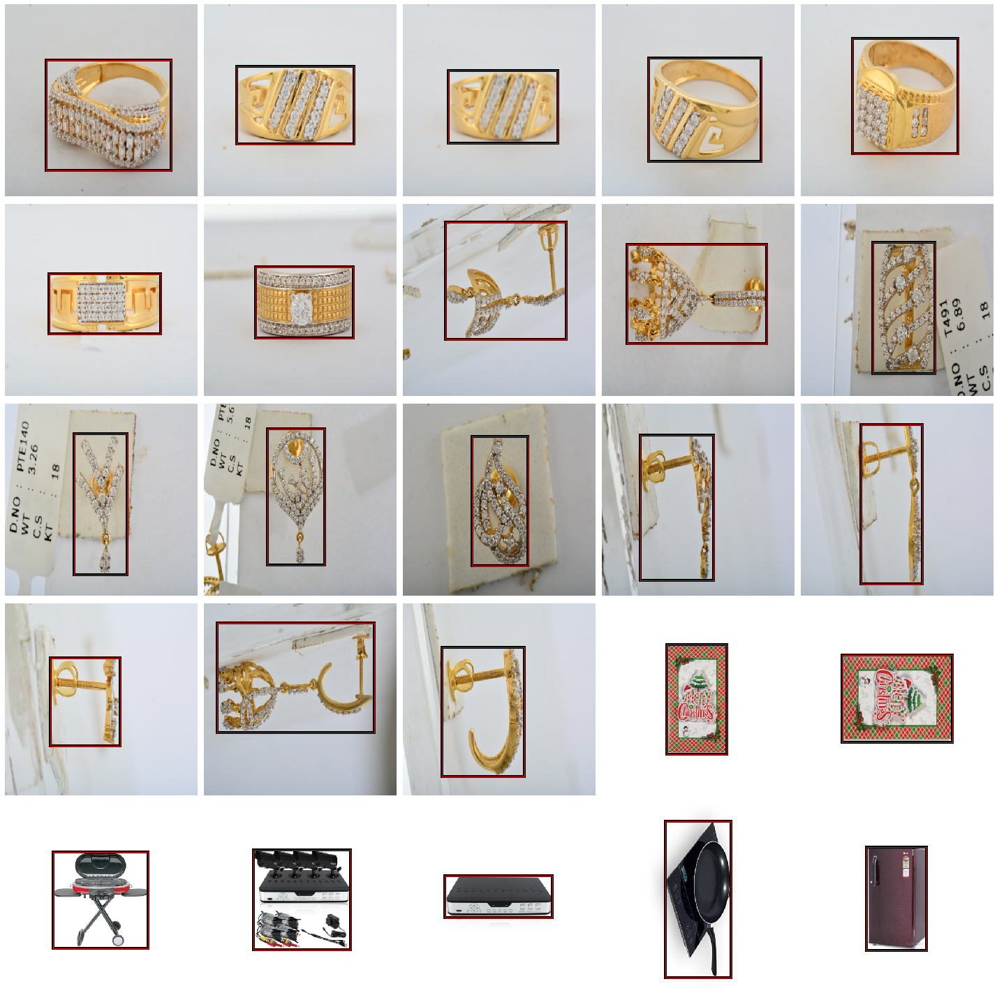

In [27]:
fig, axes = plt.subplots(5,5 , figsize=(20, 20))
for i,ax in enumerate(axes.flat):
    ima=md.val_ds.denorm(to_np(x))[i]
#     b = bb_cn_hw(preds[i])
#     b = bb_av_hw(preds[i])
    b = bb_hw(preds[i])
    ax = show_img(ima, ax=ax)
    draw_rec(ax, b)
plt.tight_layout()

**For testing run the cells below**

In [0]:
test = 'test_image'

In [34]:
!rm -r test_image
!mkdir test_image

t_df = pd.read_csv('test.csv')[['image_name']]

for i in tqdm(t_df['image_name']):
  p = "images/"+i
#   print(str(p))
  im = cv2.imread(str(p))
  npp = "test_image/"+i
  cv2.imwrite(str(npp),im)
  

100%|██████████| 24045/24045 [11:01<00:00, 36.36it/s]


In [0]:
tfm_y = TfmType.COORD
augs = [RandomFlip(tfm_y=tfm_y),
        RandomRotate(3, p=0.5, tfm_y=tfm_y),
        RandomLighting(0.05,0.05, tfm_y=tfm_y)]

tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, tfm_y=tfm_y, aug_tfms=augs)
md2 = ImageClassifierData.from_csv(path, IMAGES, BB_CSV, tfms=tfms,test_name = test, bs=bs, continuous=True)


head_reg4 = nn.Sequential(Flatten(),nn.Linear(115200,4))
learn = ConvLearner.pretrained(f_model,md2,custom_head=head_reg4,pretrained=False)
learn.opt_fn = optim.Adam
learn.crit = nn.L1Loss()

In [0]:
learn.load('weight')

In [0]:
s = len(md2.test_ds.fnames)
yp = np.zeros((s,4),dtype='float')
md2.test_ds.y = yp

In [0]:
y_pred = learn.predict(is_test=True)

In [0]:

pred_df = pd.DataFrame(data = y_pred,columns = ['y1','x1','y2','x2'])
pred_df2 = pred_df.copy()

pred_df2['y1'] = pred_df['y1']
pred_df2['x1'] = pred_df['x1']/3*4
pred_df2['y2'] = pred_df['y2']
pred_df2['x2'] = pred_df['x2']/3*4

test_df_names = pd.DataFrame({'image_name':md2.test_ds.fnames})
test_df_names['image_name'] = [str(i).replace('test_image/','') for i in test_df_names['image_name']]

test_df_names[['y1','x1','y2','x2']] = pred_df2[['y1','x1','y2','x2']]

t_df = pd.read_csv('test.csv')[['image_name']]
merged = pd.merge(t_df,test_df_names,on = ['image_name'])

submission = merged[['image_name','x1','x2','y1','y2']]
submission.to_csv('submission_ur2.csv',index=False)
